In [2]:
import pynkowski as mf   # For Minkowski Functionals

from importlib import reload
import healpy as hp
import numpy as np
import matplotlib.pyplot as plt
import scatcovjax.Sphere_lib as sphlib
import scatcovjax.plotting as plot

plot.notebook_plot_format()

In [3]:
reload(sphlib)

L=256
sampling="healpix"
reality=True

### Sky LSS
repo = '/travail/lmousset/CosmoGrid/CosmoFiducial_barionified_nside512/'
run = 1
data_LSS = np.load(repo + f'baryonified_shells_run{run:04}.npz')

In [4]:
### Get all the maps sort by redshift
shell_info, shells = sphlib.sort_CosmoGrid_maps(data_LSS)
print(shell_info)

### Get all redshifts
z_mean = sphlib.get_mean_redshift(shell_info)
print(z_mean)

[('CosmoML-shell_z-high=0.01277548_z-low=0.0.fits',  0, 0.        , 0.01277548,    0.     ,   38.20415,   19.12606 )
 ('CosmoML-shell_z-high=0.02578057_z-low=0.01277548.fits',  1, 0.01277548, 0.02578057,   38.20415,   76.89683,   57.5756  )
 ('CosmoML-shell_z-high=0.03902289_z-low=0.02578057.fits',  2, 0.02578057, 0.03902289,   76.89683,  116.0879 ,   96.518654)
 ('CosmoML-shell_z-high=0.05251003_z-low=0.03902289.fits',  3, 0.03902289, 0.05251003,  116.0879 ,  155.78632,  135.96463 )
 ('CosmoML-shell_z-high=0.06625001_z-low=0.05251003.fits',  4, 0.05251003, 0.06625001,  155.78632,  196.00148,  175.92273 )
 ('CosmoML-shell_z-high=0.08025129_z-low=0.06625001.fits',  5, 0.06625001, 0.08025129,  196.00148,  236.74321,  216.40253 )
 ('CosmoML-shell_z-high=0.09452274_z-low=0.08025129.fits',  6, 0.08025129, 0.09452274,  236.74321,  278.0215 ,  257.41397 )
 ('CosmoML-shell_z-high=0.1090737_z-low=0.09452274.fits',  7, 0.09452274, 0.1090737 ,  278.0215 ,  319.84686,  298.96732 )
 ('CosmoML-shell

In [5]:
print(map_hp.min(), map_hp.max())

NameError: name 'map_hp' is not defined

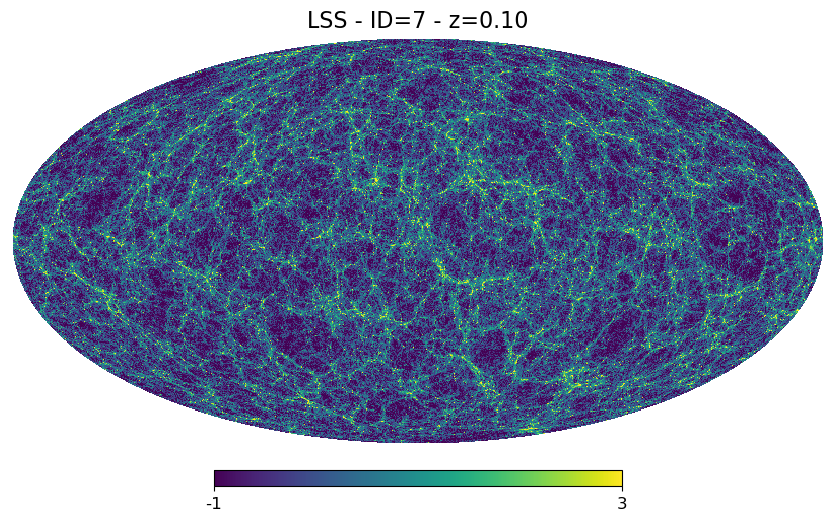

In [6]:
### Choose a given map
i = 7 # 0 to 68
map_hp = shells[i, :]
map_hp = np.log(map_hp+0.001)-2
map_info = shell_info[i]

shell_id = map_info[1]
z = sphlib.get_mean_redshift(shell_info)[i]

hp.mollview(map_hp, min=-1, max=3, title=f'LSS - ID={shell_id} - {z=:.2f}')
#hp.mollview(map_hp, norm='hist', title=f'LSS - ID={shell_id} - {z=:.2f}')

In [7]:
### Sky CMB
#map_hp, _ = sphlib.make_pysm_sky(L, 'cmb', sampling=sampling, nest=False, normalize=True, reality=reality)
#print('Target = CMB map')

In [8]:
# Make one map for synthesis
reload(sphlib)
I, Ilm = sphlib.make_CosmoGrid_sky(L, dirmap=repo, run=0, idx_z=10, sampling='mw', 
                                   nest=False, normalize=False, reality=True)



Map at redshift z=0.14677950739860535
Mean and STD: 0.995 and 0.603


In [9]:
#hp.mollview(I, norm='hist', title=f'')

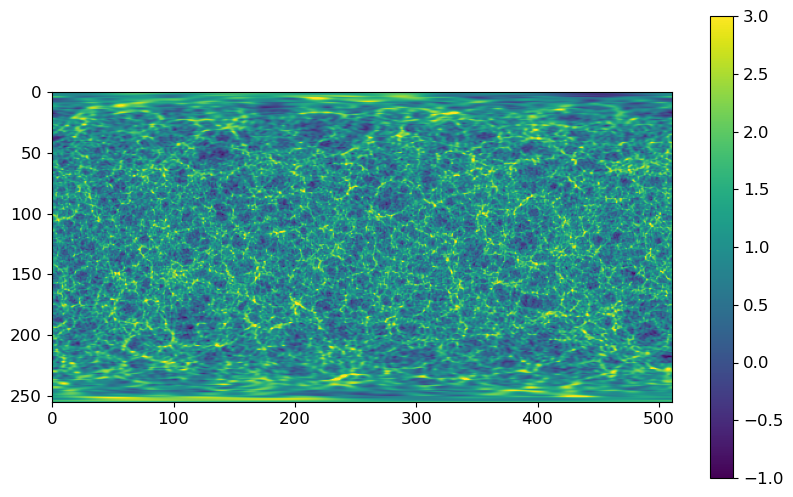

In [10]:
plt.figure(figsize=(10, 6))
plt.imshow(I, cmap='viridis', vmin=-1, vmax=3)
plt.colorbar()

<Figure size 640x480 with 0 Axes>

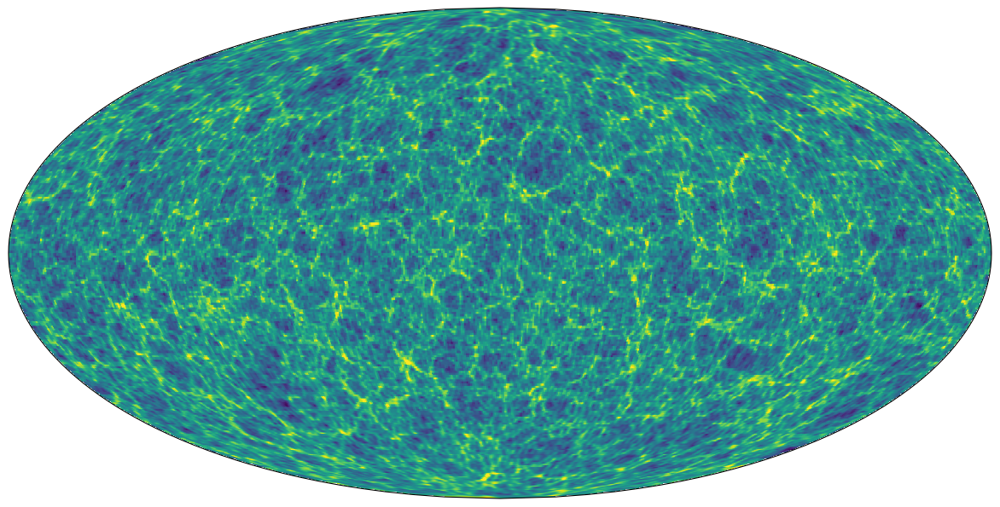

In [11]:
plt.figure()
plot.plot_map_MW_Mollweide(I, vmin=-1, vmax=3, title=f'')

# Thresholds and scalar map

We set a uniform set of thresholds from -5σ to 5σ.

And we create a Healpix object that will store the map and its derivatives, and will compute the MFs. This class is a subclass of DataField.


Information about settings

We use the default settings:

- `normalise = True`, this divides the map over the σ in such a way that we can work with adimensional us. Otherwise the thresholds have to be defined in an appropiate range for the given maps
- `mask = None`, as we do not have a mask. If a mask is given, the MFs are computed only within the mask (where mask=True). However, the spatial derivatives are always computed full sky in order to avoid numerical errors, so we recommend using inpainted maps or removing singularities on the maps.




In [14]:
type(map_hp)

numpy.ndarray

In [15]:
us = np.arange(-5., 15.01, 0.1)

data = mf.Healpix(map_hp, normalise=True, mask=None)     # Default parameters


# Computation of MFs

We compute the three MFs.


Information about derivatives Before computing v1 and v2, we have to compute the first and second derivatives of the map, respectively. This is automatically done a single time upon calling and they are then stored. If one wants to compute them beforehand, it can be done with `Map.get_second_der()` (or `Map.get_first_der()` if one wants only the first derivatives).



In [16]:
v0 = mf.V0(data, us)
v1 = mf.V1(data, us)
v2 = mf.V2(data, us)

  0%|          | 0/201 [00:00<?, ?it/s]

  0%|          | 0/201 [00:00<?, ?it/s]

  0%|          | 0/201 [00:00<?, ?it/s]

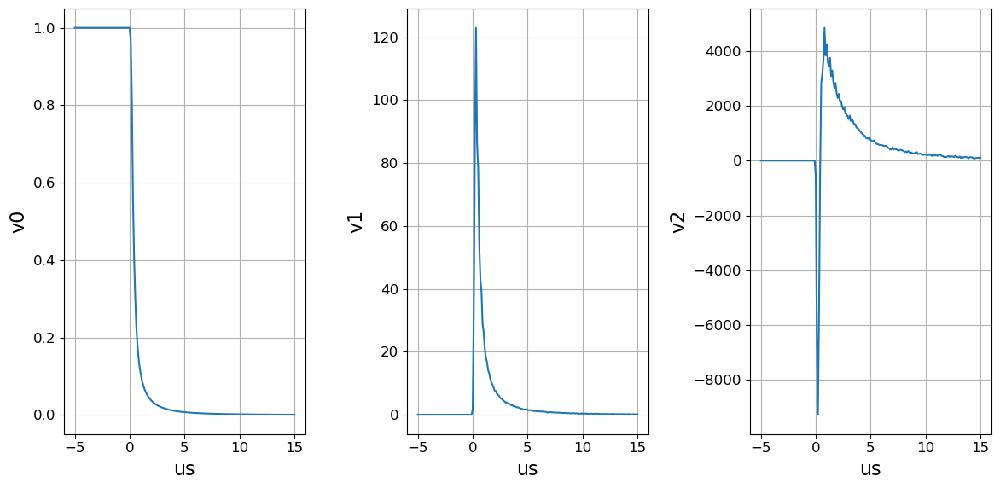

In [118]:
fig, (ax0, ax1, ax2) = plt.subplots(1, 3, figsize=(12, 6))

ax0.plot(us, v0)
ax0.set_xlabel('us')
ax0.set_ylabel('v0')
ax0.grid()

ax1.plot(us, v1)
ax1.set_xlabel('us')
ax1.set_ylabel('v1')
ax1.grid()

ax2.plot(us, v2)
ax2.set_xlabel('us')
ax2.set_ylabel('v2')
ax2.grid()

fig.tight_layout()

# Loop on maps at different z

In [97]:
map_idx = [4, 6, 8, 10, 20, 30, 40, 50, 60]
nmap = len(map_idx)

i=4


  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

i=6


  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

i=8


  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

i=10


  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

i=20


  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

i=30


  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

i=40


  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

i=50


  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

i=60


  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

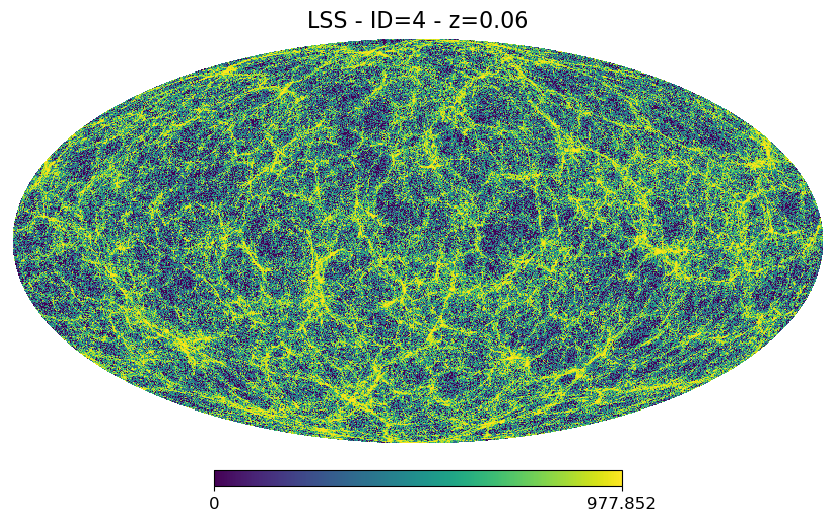

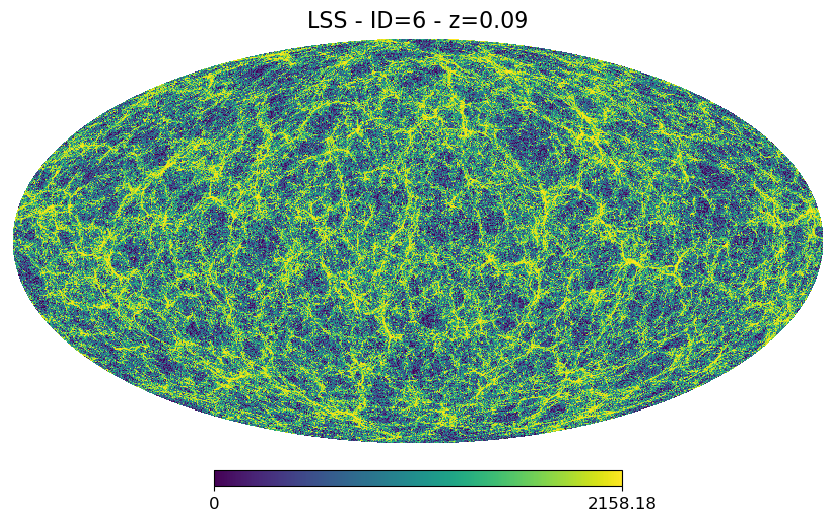

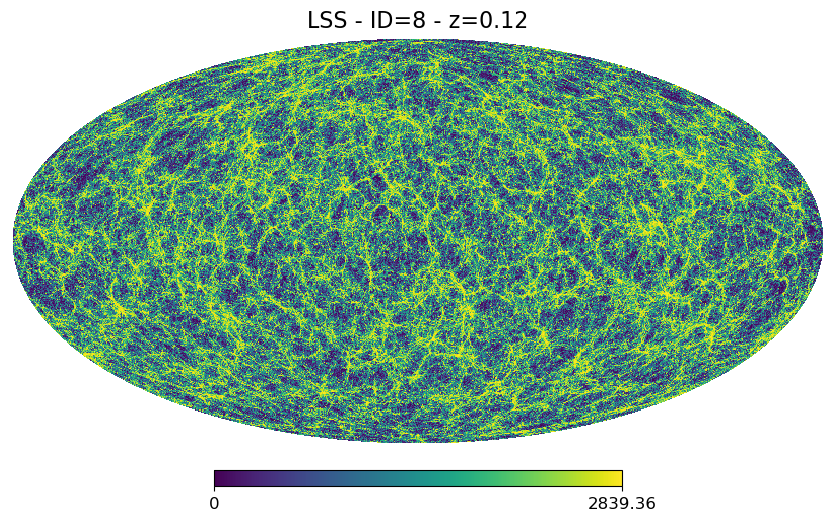

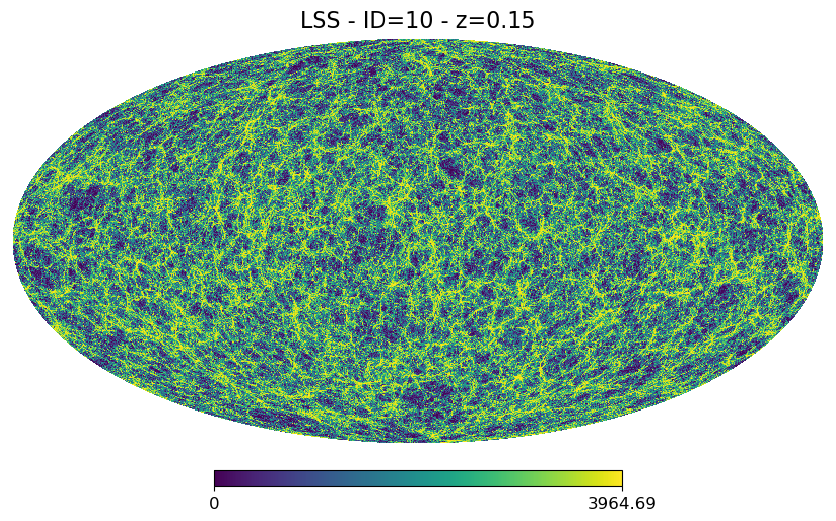

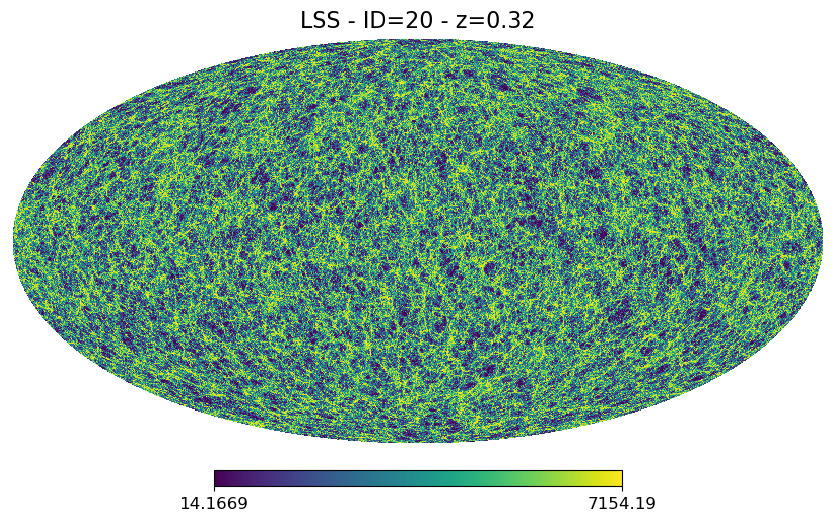

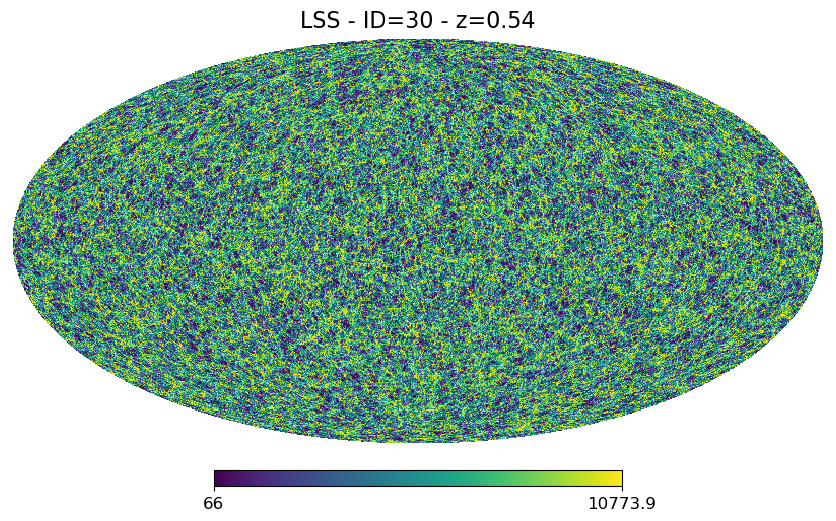

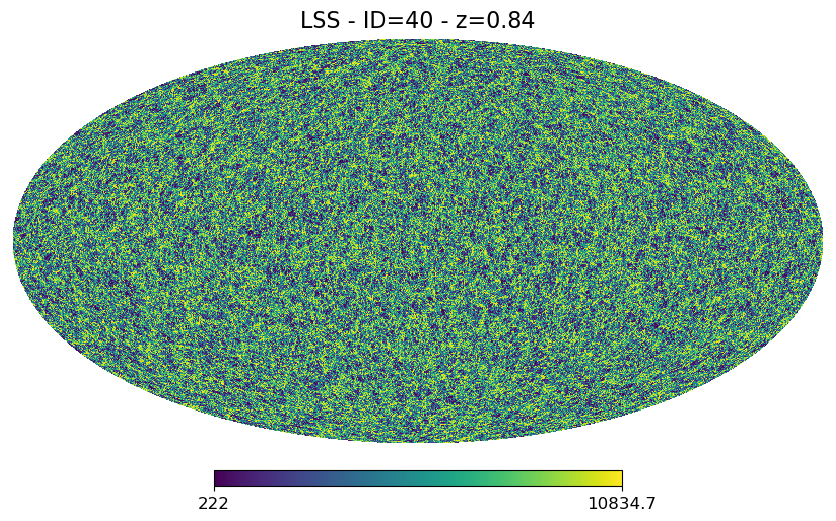

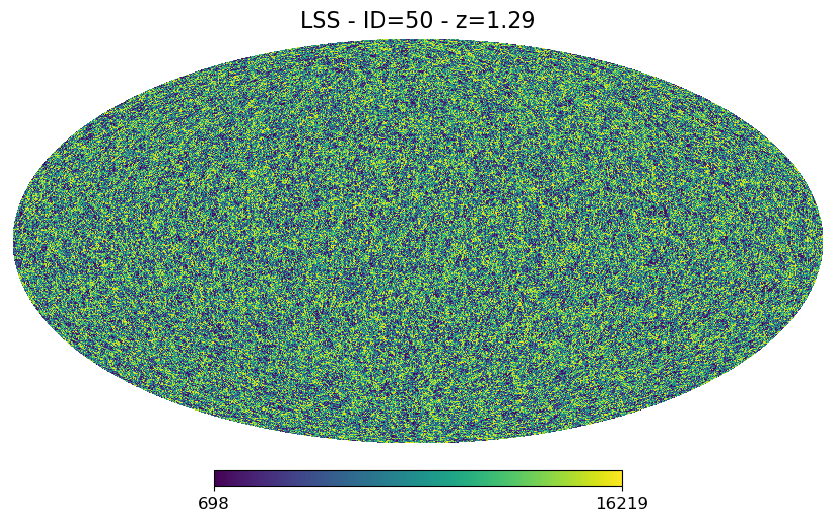

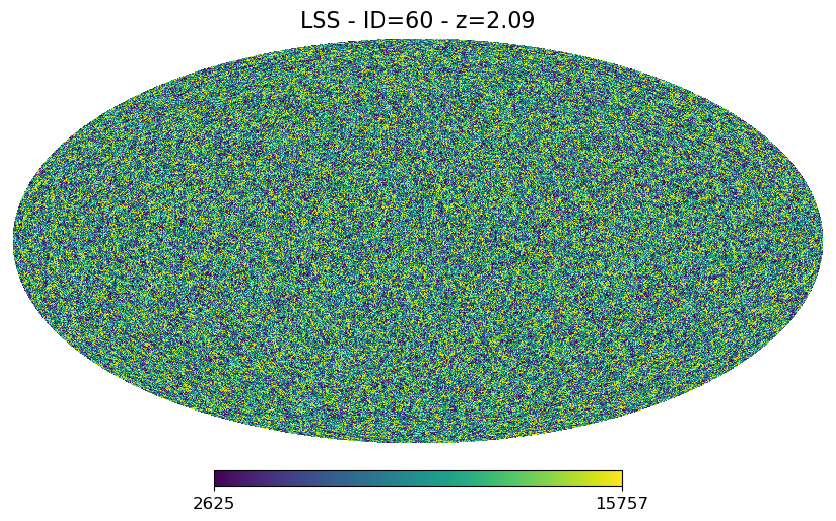

In [98]:
us = np.arange(0, 10.01, 0.1)


all_ID, all_z = [], []
all_v0, all_v1, all_v2 = [], [], []
for i in map_idx:
    print(f'{i=}')

    map_hp = shells[i, :]
    map_info = shell_info[i]

    shell_id = map_info[1]
    all_ID.append(shell_id)
    
    z = get_mean_redshift(shell_info)[i]
    all_z.append(z)

    hp.mollview(map_hp, norm='hist', title=f'LSS - ID={shell_id} - {z=:.2f}')
    
    data = mf.Healpix(map_hp, normalise=True, mask=None)     # Default parameters
    
    all_v0.append(mf.V0(data, us))
    all_v1.append(mf.V1(data, us))
    all_v2.append(mf.V2(data, us))

In [99]:
import seaborn as sns
palet = sns.color_palette("mako", n_colors=nmap)
print(palet.as_hex())

['#251729', '#382a54', '#413f80', '#395d9c', '#357ba3', '#3497a9', '#3eb4ad', '#60ceac', '#a9e1bd']


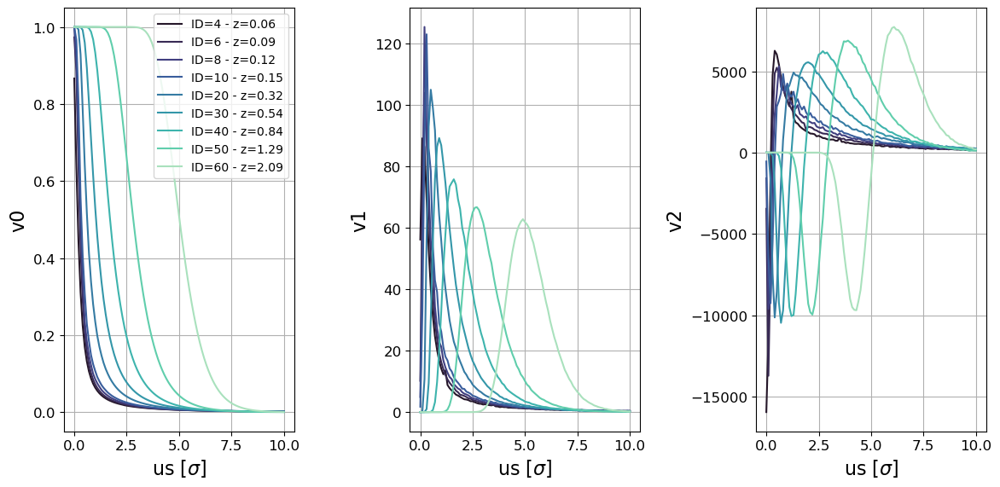

In [113]:
fig, (ax0, ax1, ax2) = plt.subplots(1, 3, figsize=(12, 6))

for i in range(nmap):
    ax0.plot(us, all_v0[i], color=palet[i], label=f'ID={all_ID[i]} - z={all_z[i]:.2f}')
ax0.set_xlabel(r'us $[\sigma]$')
ax0.set_ylabel('v0')
ax0.legend(loc='upper right', fontsize=10)
ax0.grid()

for i in range(nmap):
    ax1.plot(us, all_v1[i], color=palet[i])
ax1.set_xlabel(r'us $[\sigma]$')
ax1.set_ylabel('v1')
ax1.grid()

for i in range(nmap):
    ax2.plot(us, all_v2[i], color=palet[i])
ax2.set_xlabel(r'us $[\sigma]$')
ax2.set_ylabel('v2')
ax2.grid()


fig.tight_layout()

# Statistics on maps at one z

In [120]:
run_idx = np.arange(10)
nruns = run_idx.size
palet = sns.color_palette("flare", n_colors=nruns)
print(palet.as_hex())

['#eb9973', '#e88366', '#e46c5d', '#db565d', '#cc4664', '#b73d6b', '#a1386f', '#8b3271', '#752d6f', '#602969']


run=0


  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

run=1


  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

run=2


  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

run=3


  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

run=4


  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

run=5


  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

run=6


  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

run=7


  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

run=8


  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

run=9


  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

  0%|          | 0/101 [00:00<?, ?it/s]

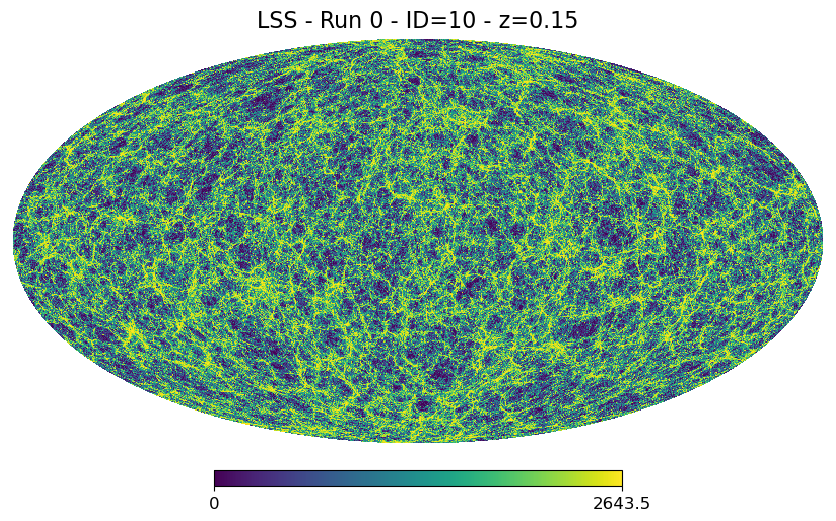

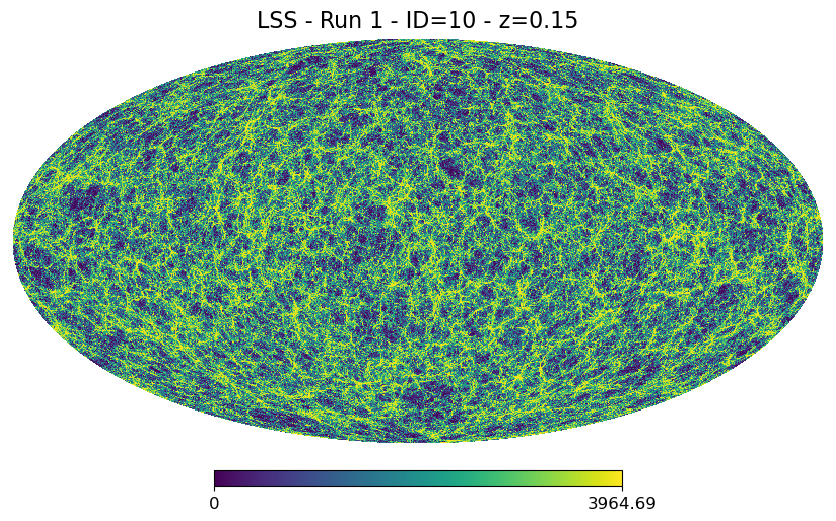

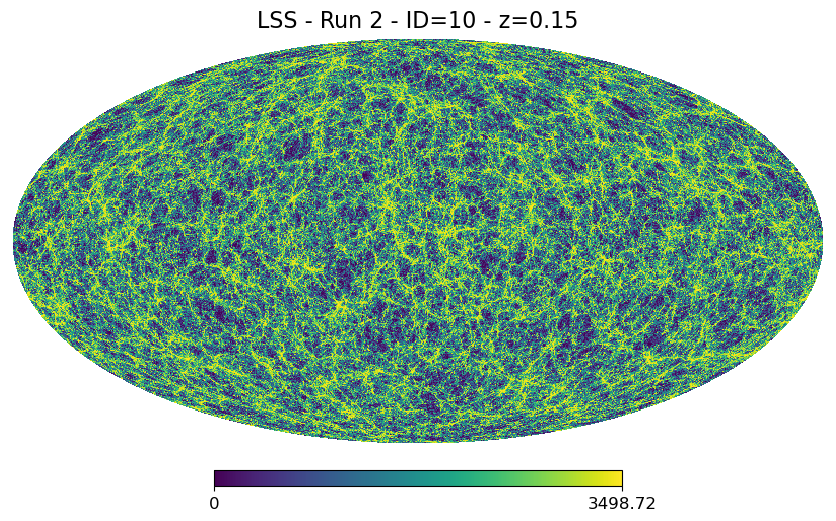

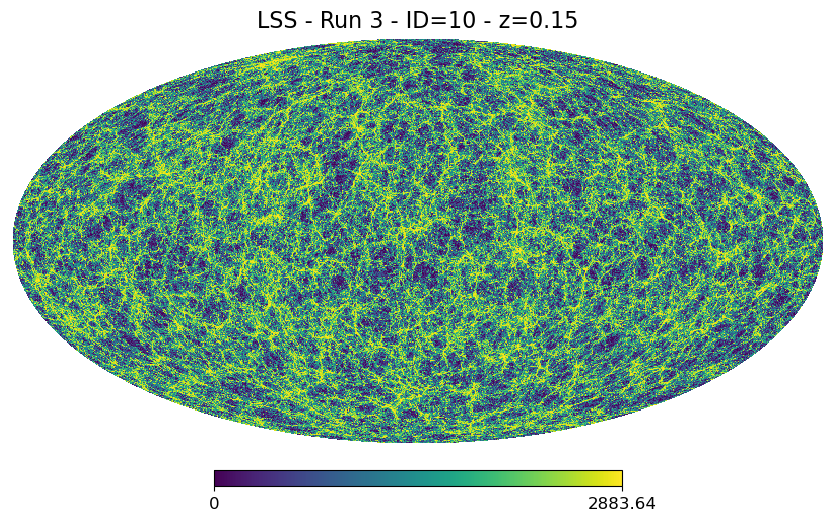

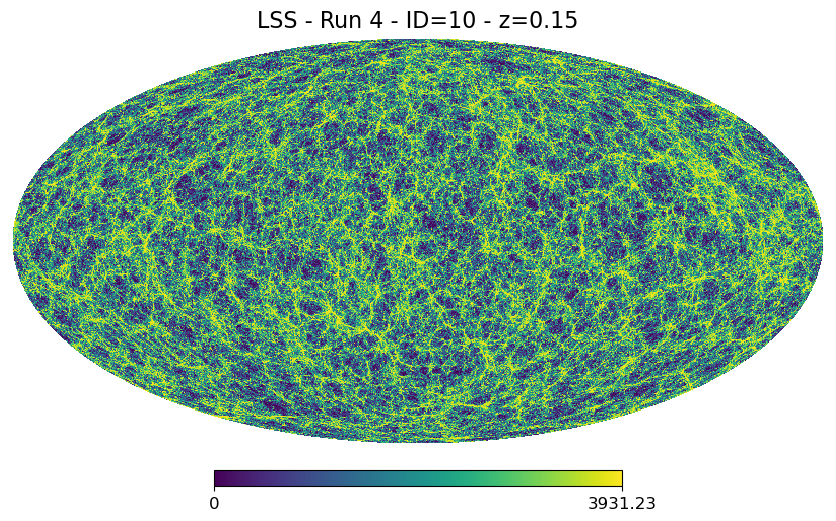

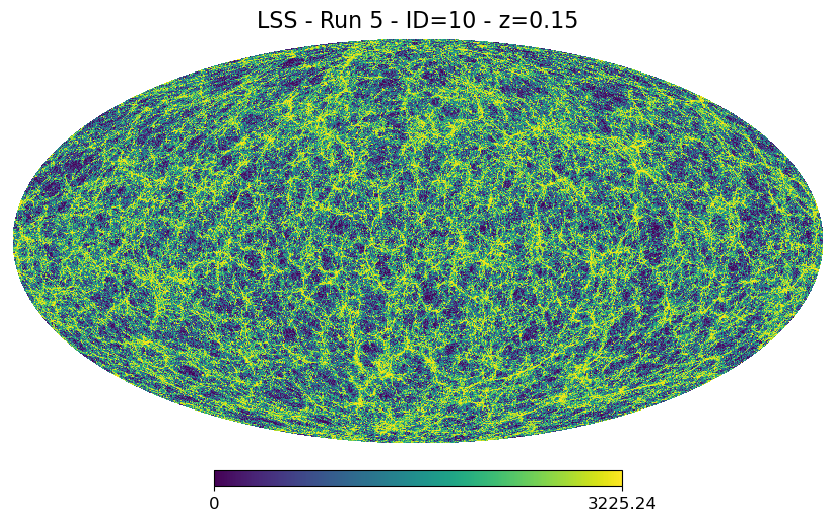

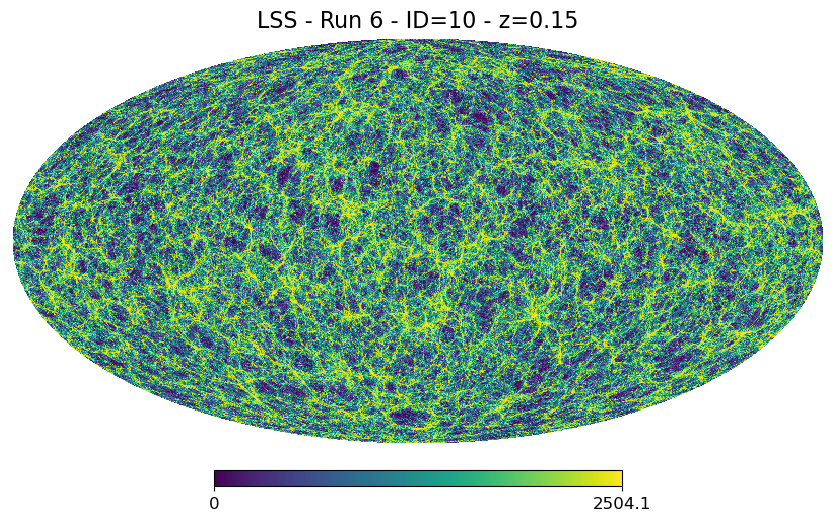

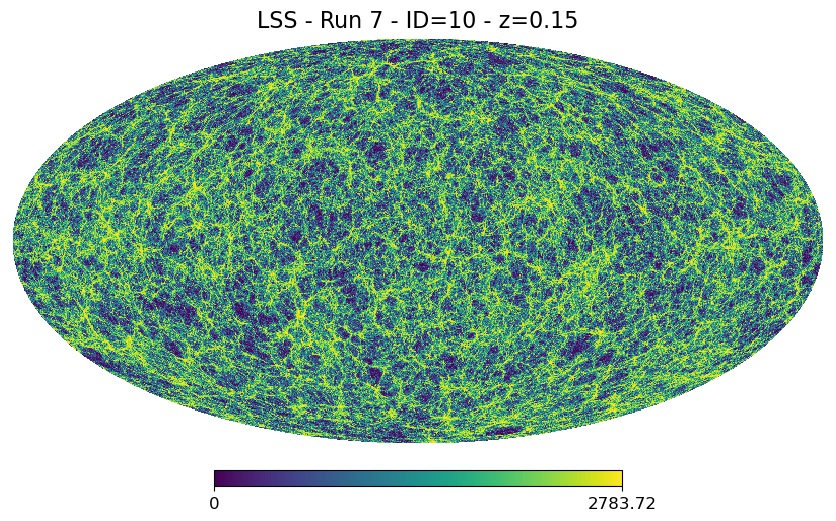

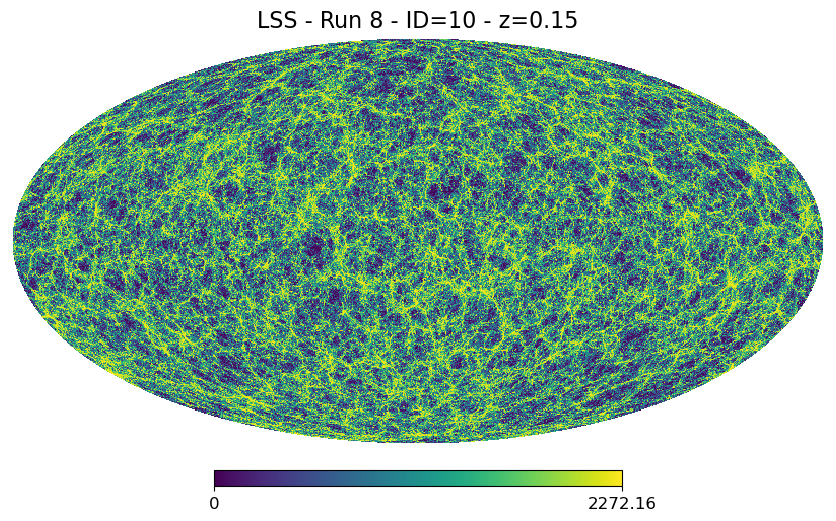

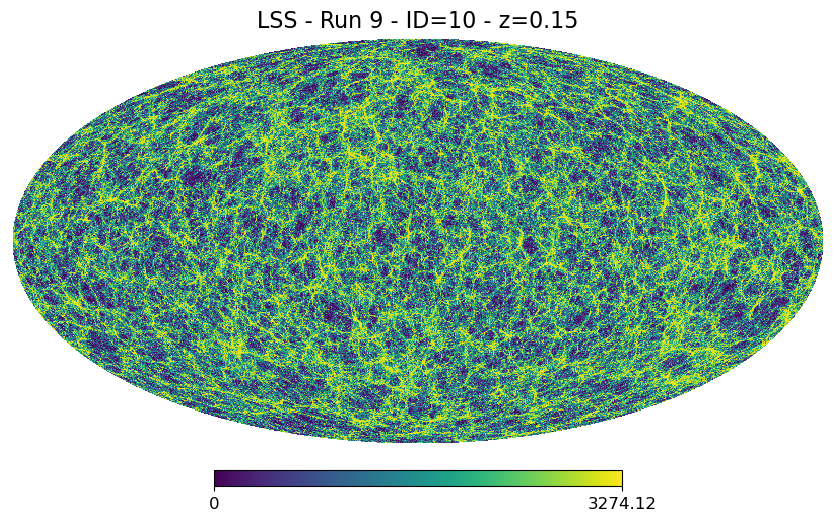

In [139]:
all_v0, all_v1, all_v2 = [], [], []

### Choose a given map
i = 10 # 0 to 68

us = np.arange(0., 10.01, 0.1)
for run in run_idx:
    print(f'{run=}')
    data_LSS = np.load(repo + f'baryonified_shells_run{run:04}.npz')

    ### Get all the maps sort by redshift
    shell_info, shells = sort_CosmoGrid_maps(data_LSS)
    
    map_hp = shells[i, :]
    map_info = shell_info[i]

    shell_id = map_info[1]
    z = get_mean_redshift(shell_info)[i]

    hp.mollview(map_hp, norm='hist', title=f'LSS - Run {run} - ID={shell_id} - {z=:.2f}')

    data = mf.Healpix(map_hp, normalise=True, mask=None)     # Default parameters

    all_v0.append(mf.V0(data, us))
    all_v1.append(mf.V1(data, us))
    all_v2.append(mf.V2(data, us))


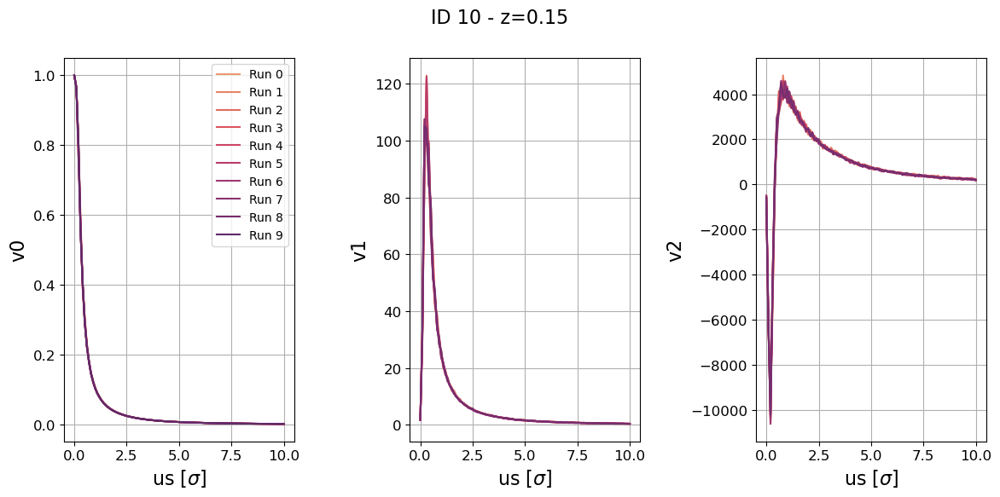

In [127]:
fig, (ax0, ax1, ax2) = plt.subplots(1, 3, figsize=(12, 6))
fig.suptitle(f'ID {shell_id} - {z=:.2f}')

for i in range(nruns):
    ax0.plot(us, all_v0[i], color=palet[i], label=f'Run {run_idx[i]}')
ax0.set_xlabel(r'us $[\sigma]$')
ax0.set_ylabel('v0')
ax0.legend(loc='upper right', fontsize=10)
ax0.grid()

for i in range(nmap):
    ax1.plot(us, all_v1[i], color=palet[i])
ax1.set_xlabel(r'us $[\sigma]$')
ax1.set_ylabel('v1')
ax1.grid()

for i in range(nmap):
    ax2.plot(us, all_v2[i], color=palet[i])
ax2.set_xlabel(r'us $[\sigma]$')
ax2.set_ylabel('v2')
ax2.grid()


fig.tight_layout()

In [132]:
np.mean(np.array(all_v0), axis=0).shape

(101,)

In [133]:
mean_v0 = np.mean(np.array(all_v0), axis=0)
mean_v1 = np.mean(np.array(all_v1), axis=0)
mean_v2 = np.mean(np.array(all_v2), axis=0)

std_v0 = np.std(np.array(all_v0), axis=0)
std_v1 = np.std(np.array(all_v1), axis=0)
std_v2 = np.std(np.array(all_v2), axis=0)

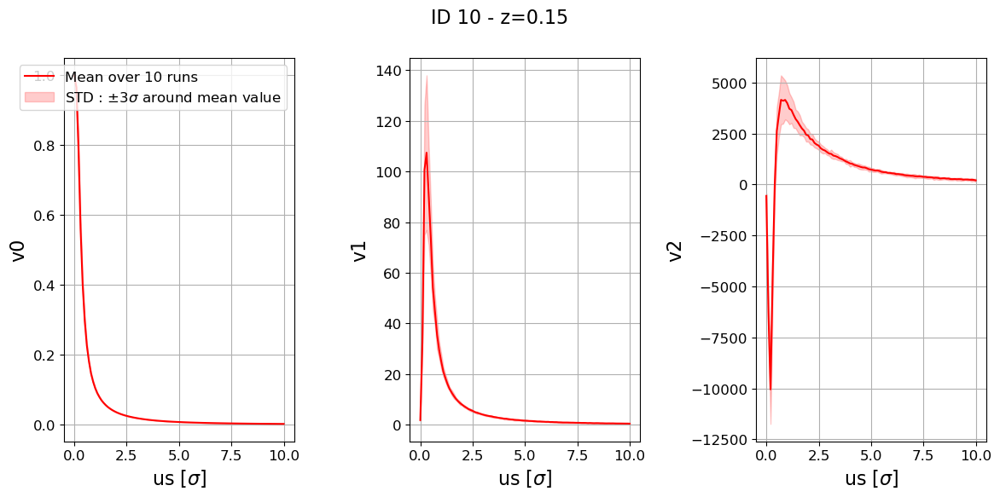

In [138]:
fig, (ax0, ax1, ax2) = plt.subplots(1, 3, figsize=(12, 6))
fig.suptitle(f'ID {shell_id} - {z=:.2f}')

ax0.plot(us, mean_v0, color='r', label=f'Mean over {nruns} runs')
ax0.fill_between(us, mean_v0 - 3*std_v0, mean_v0 + 3*std_v0, color='r', alpha=0.2, 
                 label=fr'STD : $\pm 3\sigma$ around mean value')
ax0.set_xlabel(r'us $[\sigma]$')
ax0.set_ylabel('v0')
ax0.grid()
ax0.legend(loc='upper right', fontsize=12)

ax1.plot(us, mean_v1, color='r')
ax1.fill_between(us, mean_v1 - 3*std_v1, mean_v1 + 3*std_v1, color='r', alpha=0.2)
ax1.set_xlabel(r'us $[\sigma]$')
ax1.set_ylabel('v1')
ax1.grid()

ax2.plot(us, mean_v2, color='r')
ax2.fill_between(us, mean_v2 - 3*std_v2, mean_v2 + 3*std_v2, color='r', alpha=0.2)
ax2.set_xlabel(r'us $[\sigma]$')
ax2.set_ylabel('v2')
ax2.grid()


fig.tight_layout()